In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

import gc
import warnings
import os
import time

from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold

In [6]:
train_df = pd.read_csv('../my_csv_files/MY_train_x.csv')

In [10]:
train_df.iloc[:,1:]

,EXT_SOURCE_2,EXT_SOURCE_3,INSTAL_DPD_MEAN,DAYS_EMPLOYED_PERC,AMT_ANNUITY,DAYS_EMPLOYED,PAYMENT_RATE,ACTIVE_DAYS_CREDIT_MAX,APPROVED_CNT_PAYMENT_MEAN,ANNUITY_INCOME_PERC,...,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_MEAN,APPROVED_AMT_APPLICATION_MAX,BURO_CREDIT_ACTIVE_Active_MEAN,APPROVED_CNT_PAYMENT_SUM,BURO_CREDIT_ACTIVE_Closed_MEAN,APPROVED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,APPROVED_AMT_ANNUITY_MAX,ACTIVE_AMT_CREDIT_SUM_DEBT_SUM
0,0.546272,0.511892,0.000000,0.044916,27135.0,-421.0,0.028797,-90.0,36.000000,0.172286,...,846000.000,282000.000000,441000.0,0.666667,36.0,0.333333,-697.0,-239.000000,16660.980,511245.000
1,0.672655,0.605836,0.000000,NaN,44752.5,NaN,0.027579,-118.0,17.500000,0.284143,...,1087373.610,98852.146364,229500.0,0.545455,70.0,0.454545,-304.0,-623.833333,12054.870,460984.500
2,0.587995,NaN,0.068966,NaN,25677.0,NaN,0.079400,NaN,8.000000,0.178313,...,NaN,NaN,405000.0,NaN,24.0,NaN,-321.0,NaN,25264.125,NaN
3,0.638957,0.401407,0.051282,0.065774,9000.0,-923.0,0.050000,-124.0,27.000000,0.111111,...,315000.000,315000.000000,137047.5,1.000000,54.0,0.000000,-446.0,-124.000000,10629.720,299691.000
4,0.510060,0.501075,NaN,0.052903,23931.0,-431.0,0.029398,-69.0,NaN,0.212720,...,981000.000,327000.000000,NaN,0.666667,NaN,0.333333,NaN,-393.000000,NaN,720877.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49709,0.329708,0.360613,0.000000,0.307320,32746.5,-3048.0,0.072770,-227.0,9.000000,0.158196,...,7601734.845,691066.804091,70641.0,0.363636,18.0,0.636364,-410.0,-355.250000,5364.945,4728279.015
49710,0.583214,0.424130,0.172589,0.179264,46809.0,-2405.0,0.035919,-170.0,17.777778,0.325062,...,4848546.150,484854.615000,900000.0,0.400000,160.0,0.600000,-894.0,-477.750000,50106.735,747031.500
49711,0.713524,0.511892,6.522843,0.152441,19975.5,-3147.0,0.067258,-354.0,30.000000,0.088780,...,3714192.000,412688.000000,270000.0,0.666667,60.0,0.333333,-942.0,-879.500000,17900.910,2797449.840
49712,0.615261,0.397946,0.035714,0.017364,23089.5,-286.0,0.044294,-203.0,6.000000,0.102620,...,282663.315,282663.315000,81810.0,1.000000,12.0,0.000000,-307.0,-203.000000,9115.560,223943.895


In [34]:
features = pd.read_csv('../my_csv_files/feats_import_combined_lgbm128_mssing.csv')
ft_select = list(features["feature"]) + ['SK_ID_CURR']

In [3]:
#merged_version = pd.read_csv('../my_csv_files/MY_merged_train.csv')

In [27]:
df_for_modelling = pd.read_csv('../my_csv_files/df_for_modelling.csv')

In [28]:
df_for_modelling.columns

Index(['Unnamed: 0', 'index', 'SK_ID_CURR', 'TARGET', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT',
       ...
       'CC_NAME_CONTRACT_STATUS_Signed_MAX',
       'CC_NAME_CONTRACT_STATUS_Signed_MEAN',
       'CC_NAME_CONTRACT_STATUS_Signed_SUM',
       'CC_NAME_CONTRACT_STATUS_Signed_VAR', 'CC_NAME_CONTRACT_STATUS_nan_MIN',
       'CC_NAME_CONTRACT_STATUS_nan_MAX', 'CC_NAME_CONTRACT_STATUS_nan_MEAN',
       'CC_NAME_CONTRACT_STATUS_nan_SUM', 'CC_NAME_CONTRACT_STATUS_nan_VAR',
       'CC_COUNT'],
      dtype='object', length=799)

In [29]:
#df_for_modelling.iloc[:,1:]

# Create arrays and dataframes to store results
feats = [f for f in df_for_modelling.columns if f not in ['TARGET', 'Unnamed: 0', 'Unnamed0',
                                                           'SK_ID_BUREAU','SK_ID_PREV',
                                                           'index']]
# 'SK_ID_CURR',
df_no_adds = df_for_modelling[feats]

In [37]:
df_selec_plus_sk_id = df_no_adds[ft_select]
df_selec_plus_sk_id.to_csv('../my_csv_files/df_selec_plus_sk_id.csv')

In [53]:
type(df_selec_plus_sk_id["SK_ID_CURR"][0])

numpy.int64

In [51]:
456250-100002

356248

In [41]:
shap_data = df_selec_plus_sk_id.iloc[:,1:]

shap_data_plot  = shap_data.drop("SK_ID_CURR",  axis = 1)

In [50]:
shap_data.index[shap_data["SK_ID_CURR"] == 100002]


Int64Index([0], dtype='int64')

In [39]:
df_selec_plus_sk_id.drop("SK_ID_CURR", axis = 1)

,EXT_SOURCE_2,EXT_SOURCE_3,INSTAL_DPD_MEAN,DAYS_EMPLOYED_PERC,AMT_ANNUITY,DAYS_EMPLOYED,PAYMENT_RATE,ACTIVE_DAYS_CREDIT_MAX,APPROVED_CNT_PAYMENT_MEAN,ANNUITY_INCOME_PERC,...,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_MEAN,APPROVED_AMT_APPLICATION_MAX,BURO_CREDIT_ACTIVE_Active_MEAN,APPROVED_CNT_PAYMENT_SUM,BURO_CREDIT_ACTIVE_Closed_MEAN,APPROVED_DAYS_DECISION_MAX,ACTIVE_DAYS_CREDIT_MEAN,APPROVED_AMT_ANNUITY_MAX,ACTIVE_AMT_CREDIT_SUM_DEBT_SUM
0,0.262949,0.139376,0.000000,0.067329,24700.5,-637.0,0.060749,-103.0,24.000000,0.121978,...,865055.565,1.081319e+05,179055.0,0.250000,24.0,0.750000,-606.0,-572.5,9251.775,245781.000
1,0.622246,NaN,0.000000,0.070862,35698.5,-1188.0,0.027598,-606.0,10.000000,0.132217,...,1017400.500,2.543501e+05,900000.0,0.250000,30.0,0.750000,-746.0,-606.0,98356.995,0.000
2,0.555912,0.729567,0.000000,0.011814,6750.0,-225.0,0.050000,NaN,4.000000,0.100000,...,189037.800,9.451890e+04,24282.0,0.000000,4.0,1.000000,-815.0,NaN,5357.250,NaN
3,0.650442,NaN,0.000000,0.159905,29686.5,-3039.0,0.094941,NaN,18.000000,0.219900,...,NaN,NaN,675000.0,NaN,90.0,NaN,-181.0,NaN,39954.510,NaN
4,0.322738,NaN,0.954545,0.152418,21865.5,-3038.0,0.042623,NaN,20.666667,0.179963,...,146250.000,1.462500e+05,247500.0,0.000000,124.0,1.000000,-374.0,NaN,22678.785,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
356246,0.648575,0.643026,0.000000,0.258838,17473.5,-5169.0,0.042354,-303.0,24.000000,0.143815,...,1118799.000,2.237598e+05,225000.0,0.400000,24.0,0.600000,-683.0,-452.0,14222.430,556470.000
356247,0.684596,NaN,0.520548,0.102718,31909.5,-1149.0,0.051267,NaN,17.500000,0.202600,...,NaN,NaN,184500.0,NaN,70.0,NaN,-770.0,NaN,14571.765,NaN
356248,0.632770,0.283712,0.000000,0.190742,33205.5,-3037.0,0.105414,-229.0,11.000000,0.163978,...,2156309.460,4.312619e+05,170824.5,0.200000,22.0,0.800000,-84.0,-229.0,15761.205,21343.500
356249,0.445701,0.595456,0.034483,0.195518,25128.0,-2731.0,0.055840,-890.0,17.000000,0.111680,...,3848684.310,2.263932e+05,400950.0,0.352941,34.0,0.647059,-577.0,-1077.5,23451.705,787678.560


In [5]:
df_for_modelling["TARGET"]

0         1.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
356246    NaN
356247    NaN
356248    NaN
356249    NaN
356250    NaN
Name: TARGET, Length: 356251, dtype: float64

In [22]:
df_for_modelling.columns[:50]

Index(['Unnamed: 0', 'index', 'SK_ID_CURR', 'TARGET', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_1',
       'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG',
       'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG',
       'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG',
       'LANDA

In [29]:
df_for_modelling['NAME_CONTRACT_TYPE_Cash loans']

0         1
1         1
2         0
3         1
4         1
         ..
356246    1
356247    1
356248    1
356249    1
356250    1
Name: NAME_CONTRACT_TYPE_Cash loans, Length: 356251, dtype: int64

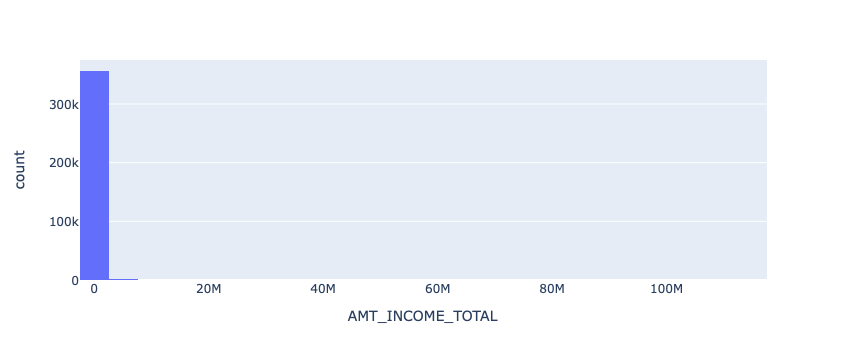

In [11]:
import plotly.express as px

df = df_for_modelling
# Here we use a column with categorical data
#fig = px.histogram(df, x = "AMT_CREDIT")
fig = px.histogram(df, x = "AMT_INCOME_TOTAL", nbins = 40)
fig.show()

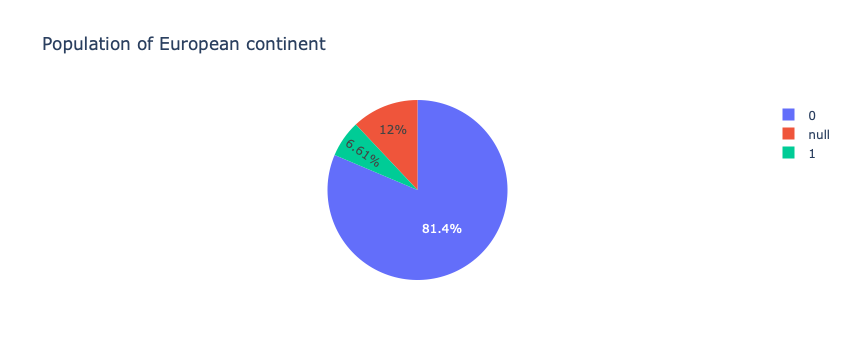

In [18]:
import plotly.express as px

df = df_for_modelling

fig = px.pie(df, values='AMT_CREDIT', names='TARGET', title='Population of European continent')
fig.show()

In [23]:
df = pd.read_csv('../Projet+Mise+en+prod+-+home-credit-default-risk/application_train.csv')
test_df = pd.read_csv('../Projet+Mise+en+prod+-+home-credit-default-risk/application_test.csv')
    
df_app = df.append(test_df)



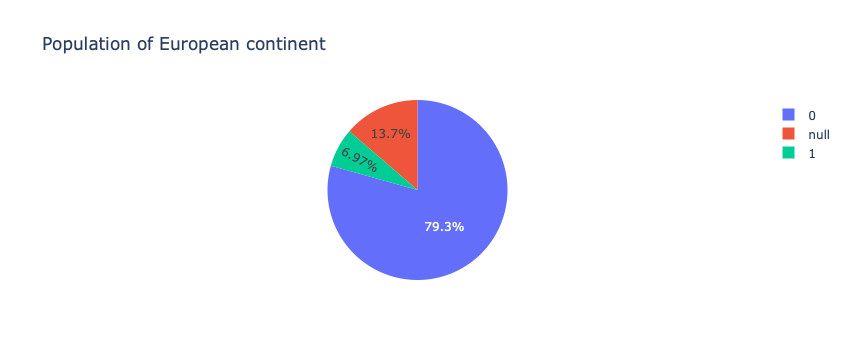

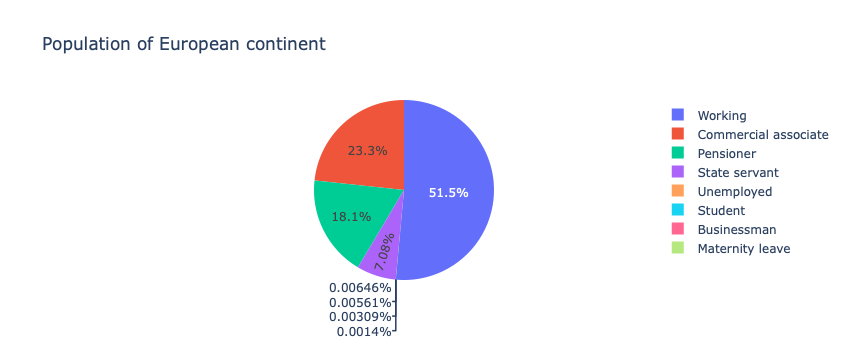

In [31]:
import plotly.express as px

df = df_for_modelling

fig = px.pie(df, names='TARGET', title='Population of European continent')
fig.show()

fig = px.pie(df_app, names = 'NAME_INCOME_TYPE', title='Population of European continent')
fig.show()

In [4]:
fig = px.pie(df_app, names = 'NAME_CONTRACT_TYPE', title='Continent')
fig.show()

NameError: name 'px' is not defined